## 1.c001~c004原图投影到鸟瞰图
```
S01 c001~c004 
/aic/code/AIC21-MTMC/datasets/detection/images/train/S01/c001/img1/img000000.jpg
/aic/code/AIC21-MTMC/datasets/detection/images/train/S01/c002/img1/img000000.jpg
/aic/code/AIC21-MTMC/datasets/detection/images/train/S01/c003/img1/img000000.jpg
/aic/code/AIC21-MTMC/datasets/detection/images/train/S01/c004/img1/img000000.jpg

S01 bev
/aic/code/ALF-CMVT/IPM/NW_JohnFbev.png
```

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


<Figure size 640x480 with 0 Axes>

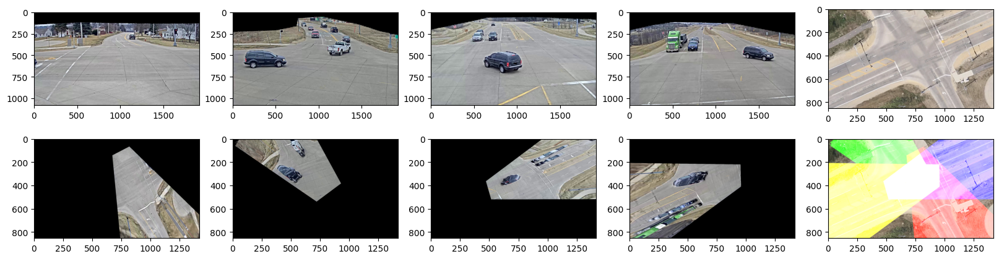

In [4]:
import matplotlib.pyplot as plt
import numpy as np
import cv2

def get_mask(img_rgb):
    # 获取img指定区域颜色值不是全黑色的单通道图
    mask = img_rgb == [0,0,0]
    mask = np.all(mask, axis=2) # 按通道进行或运算
    mask = np.bitwise_not(mask) # 按位取反
    # plt.imshow(mask)
    return mask
def add_img(bev_img, img, color, opactity=0.1):
    # 获取img的mask,并设置color
    mask = get_mask(img)
    mask_rgb = np.zeros(bev_img.shape, dtype=np.float32)
    mask_rgb[mask] = color
    # 与原图进行叠加
    result = cv2.addWeighted(bev_img, 1, mask_rgb, opactity, 0)
    return result

plt.figure()
fig, axes = plt.subplots(2,5, figsize=(20, 5))
# 原图路径
c001_img_p = r'/aic/code/AIC21-MTMC/datasets/detection/images/train/S01/c001/img1/img000000.jpg'
c002_img_p = r'/aic/code/AIC21-MTMC/datasets/detection/images/train/S01/c002/img1/img000000.jpg'
c003_img_p = r'/aic/code/AIC21-MTMC/datasets/detection/images/train/S01/c003/img1/img000000.jpg'
c004_img_p = r'/aic/code/AIC21-MTMC/datasets/detection/images/train/S01/c004/img1/img000000.jpg'
# 投影矩阵
c001_hom_p = r'trans_cfg/c001_trans_bev.npy'
c002_hom_p = r'trans_cfg/c002_trans_bev.npy'
c003_hom_p = r'trans_cfg/c003_trans_bev.npy'
c004_hom_p = r'trans_cfg/c004_trans_bev.npy'
# bev路径
bev_img_p = r'/aic/code/ALF-CMVT/TSMatchNet/NW_JohnFbev.png'
# 相机的投影矩阵
c001_hom = np.load(c001_hom_p) 
c002_hom = np.load(c002_hom_p)
c003_hom = np.load(c003_hom_p)
c004_hom = np.load(c004_hom_p)

c001_img = plt.imread(c001_img_p)
c002_img = plt.imread(c002_img_p)
c003_img = plt.imread(c003_img_p)
c004_img = plt.imread(c004_img_p)
bev_img = plt.imread(bev_img_p) # png 

# 原图
axes[0][0].imshow(c001_img)
axes[0][1].imshow(c002_img)
axes[0][2].imshow(c003_img)
axes[0][3].imshow(c004_img)
axes[0][4].imshow(bev_img)


c001_img_bev = cv2.warpPerspective(src=c001_img, M=c001_hom, dsize=bev_img.shape[1::-1]) # (1419, 853)
c002_img_bev = cv2.warpPerspective(src=c002_img, M=c002_hom, dsize=bev_img.shape[1::-1])
c003_img_bev = cv2.warpPerspective(src=c003_img, M=c003_hom, dsize=bev_img.shape[1::-1])
c004_img_bev = cv2.warpPerspective(src=c004_img, M=c004_hom, dsize=bev_img.shape[1::-1])
# 投影图
axes[1][0].imshow(c001_img_bev)
axes[1][1].imshow(c002_img_bev)
axes[1][2].imshow(c003_img_bev)
axes[1][3].imshow(c004_img_bev)

tmp = add_img(bev_img, c001_img_bev, (255,0,0,0))
tmp = add_img(tmp, c002_img_bev, (0,255,0,0))
tmp = add_img(tmp, c003_img_bev, (0,0,255,0))
tmp = add_img(tmp, c004_img_bev, (255,255,0,0))

axes[1][4].imshow(tmp)

## 2.读取annotation, 然后将车辆轨迹投影到鸟瞰图

```
S01 c001~c004 
/aic/datasets/AIC22_Track1_MTMC_Tracking/train/S01/c001/gt/gt.txt
/aic/datasets/AIC22_Track1_MTMC_Tracking/train/S01/c002/gt/gt.txt
/aic/datasets/AIC22_Track1_MTMC_Tracking/train/S01/c003/gt/gt.txt
/aic/datasets/AIC22_Track1_MTMC_Tracking/train/S01/c004/gt/gt.txt

```
ori_gt-> ['frame', 'ID', 'left', 'top', 'width', 'height', 'conf', '-1', '-1', '-1'] 
step1 -> ['frame', 'ID', 'left', 'top', 'width', 'height', 'conf', 'px', 'py', 'bx', 'by']
step2-> ['cam', 'frame', 'ID', 'left', 'top', 'width', 'height', 'conf', 'px', 'py', 'bx', 'by']

In [5]:
# 这种方式读txt会带\n，还要额外处理，不如直接使用pandas
# with open(c001_gt_p, 'r') as f:
#     c001_gt = f.readlines()
import pandas as pd
def _calc_bev_pos(src_point_M, warpMatrix):
        '''点的透视变换，矩阵优化版
        Args:
            src_point_M():
            warpMatrix():
        '''
        one_column = np.ones((len(src_point_M), 1))
        src_point_M = np.column_stack((src_point_M, one_column))
        tar_pt = np.matmul(src_point_M, warpMatrix.T)
        tar_pt[:, 0] = tar_pt[:, 0] / tar_pt[:, 2]
        tar_pt[:, 1] = tar_pt[:, 1] / tar_pt[:, 2]
        return tar_pt[:, 0:2]
    
def calc_bev_pos(cam_gt_p, warpMatrix):
    cam_gt = pd.read_csv(cam_gt_p, delimiter=',')
    cam_gt.columns = ['frame', 'ID', 'left', 'top', 'width', 'height', 'conf', '-1', '-1', '-1']
    cam_gt = cam_gt.drop('-1', axis=1)
    # 读取width和height
    cam_gt_sub = cam_gt[['left', 'top', 'width', 'height']].values
    cam_gt_sub_x = cam_gt_sub[:, 0] + cam_gt_sub[:, 2] / 2
    cam_gt_sub_y = cam_gt_sub[:, 1] + cam_gt_sub[:, 3] / 4 * 3
    print(cam_gt_sub_y.shape)
    cam_gt['px'] = cam_gt_sub_x
    cam_gt['py'] = cam_gt_sub_y
    tar_pt_M = _calc_bev_pos(cam_gt[['px', 'py']], warpMatrix)
    cam_gt[['bx', 'by']] = tar_pt_M
    # print(cam_gt)
    return cam_gt

c001_gt_p = r'/aic/datasets/AIC22_Track1_MTMC_Tracking/train/S01/c001/gt/gt.txt'
c002_gt_p = r'/aic/datasets/AIC22_Track1_MTMC_Tracking/train/S01/c002/gt/gt.txt'
c003_gt_p = r'/aic/datasets/AIC22_Track1_MTMC_Tracking/train/S01/c003/gt/gt.txt'
c004_gt_p = r'/aic/datasets/AIC22_Track1_MTMC_Tracking/train/S01/c004/gt/gt.txt'

# c001_gt_pd = calc_bev_pos(c001_gt_p, c001_hom)
# print(c001_gt_pd)

### 2.0.Merge S01_gt将SO1的标注合并在同一个文件下

In [3]:
# c001_gt_pd = calc_bev_pos(c001_gt_p, c001_hom)
# c001_gt_pd.insert(loc=0, column='cam', value='1')
# c002_gt_pd = calc_bev_pos(c002_gt_p, c002_hom)
# c002_gt_pd.insert(loc=0, column='cam', value='2')
# c003_gt_pd = calc_bev_pos(c003_gt_p, c003_hom)
# c003_gt_pd.insert(loc=0, column='cam', value='3')
# c004_gt_pd = calc_bev_pos(c004_gt_p, c004_hom)
# c004_gt_pd.insert(loc=0, column='cam', value='4')

# S01_pd = pd.concat([c001_gt_pd, c002_gt_pd, c003_gt_pd, c004_gt_pd], axis = 0, ignore_index = True, join = "outer")
# # S01_pd = pd.concat([c001_gt_pd.head(2), c002_gt_pd.head(2), c003_gt_pd.head(2), c004_gt_pd.head(2)], axis = 0, ignore_index =True, join = "outer")
# print(S01_pd)

(3311,)
(6323,)
(6679,)
(6015,)
      cam  frame  ID  left  top  width  height  conf      px      py  \
0       1     56  34  1509  347    411     160     1  1714.5  467.00   
1       1     57  34  1445  345    432     157     1  1661.0  462.75   
2       1     58  34  1378  343    433     158     1  1594.5  461.50   
3       1     59  34  1312  344    430     157     1  1527.0  461.75   
4       1     60  34  1247  344    428     156     1  1461.0  461.00   
...    ..    ...  ..   ...  ...    ...     ...   ...     ...     ...   
22323   4   2106  94   103  532    288     235     1   247.0  708.25   
22324   4   2107  94    55  546    309     246     1   209.5  730.50   
22325   4   2108  94    28  571    322     272     1   189.0  775.00   
22326   4   2109  94     5  584    328     288     1   169.0  800.00   
22327   4   2110  94     0  628    292     283     1   146.0  840.25   

               bx          by  
0      750.572536  534.736735  
1      762.990196  536.714980  
2      

In [6]:

# S01_gt merge from c001,2,3,4
# 还应该做一下帧同步，因为四个摄像头在初始帧不是同一时间，可视化这里不需要帧同步，但是TSMAtch训练的时候是要统一时间戳的！！！
# c001_gt_pd = c001_gt_pd['frame'] + 1
fps=10
timestamp = [0, 1.640, 2.049, 2.177, 2.235]
timestamp = list(map(lambda x: int(x*10), timestamp))


c001_gt_pd = calc_bev_pos(c001_gt_p, c001_hom) # add bev position column
c001_gt_pd['frame'] = c001_gt_pd['frame'] + timestamp[0]
c001_gt_pd.insert(loc=0, column='cam', value='1') # merge

c002_gt_pd = calc_bev_pos(c002_gt_p, c002_hom)
c002_gt_pd['frame'] = c002_gt_pd['frame'] + timestamp[1]
c002_gt_pd.insert(loc=0, column='cam', value='2')

c003_gt_pd = calc_bev_pos(c003_gt_p, c003_hom)
c003_gt_pd['frame'] = c003_gt_pd['frame'] + timestamp[2]
c003_gt_pd.insert(loc=0, column='cam', value='3')

c004_gt_pd = calc_bev_pos(c004_gt_p, c004_hom)
c004_gt_pd['frame'] = c004_gt_pd['frame'] + timestamp[3]
c004_gt_pd.insert(loc=0, column='cam', value='4')

S01_pd = pd.concat([c001_gt_pd, c002_gt_pd, c003_gt_pd, c004_gt_pd], axis = 0, ignore_index = True, join = "outer")
print(S01_pd)

(3311,)
(6323,)
(6679,)
(6015,)
      cam  frame  ID  left  top  width  height  conf      px      py  \
0       1     56  34  1509  347    411     160     1  1714.5  467.00   
1       1     57  34  1445  345    432     157     1  1661.0  462.75   
2       1     58  34  1378  343    433     158     1  1594.5  461.50   
3       1     59  34  1312  344    430     157     1  1527.0  461.75   
4       1     60  34  1247  344    428     156     1  1461.0  461.00   
...    ..    ...  ..   ...  ...    ...     ...   ...     ...     ...   
22323   4   2127  94   103  532    288     235     1   247.0  708.25   
22324   4   2128  94    55  546    309     246     1   209.5  730.50   
22325   4   2129  94    28  571    322     272     1   189.0  775.00   
22326   4   2130  94     5  584    328     288     1   169.0  800.00   
22327   4   2131  94     0  628    292     283     1   146.0  840.25   

               bx          by  
0      750.572536  534.736735  
1      762.990196  536.714980  
2      

### 2.1.摄像头为单位的轨迹可视化

#### 2.1.1.单摄像头标注信息的指定轨迹显示在对应相机的图像和鸟瞰图上


<Figure size 640x480 with 0 Axes>

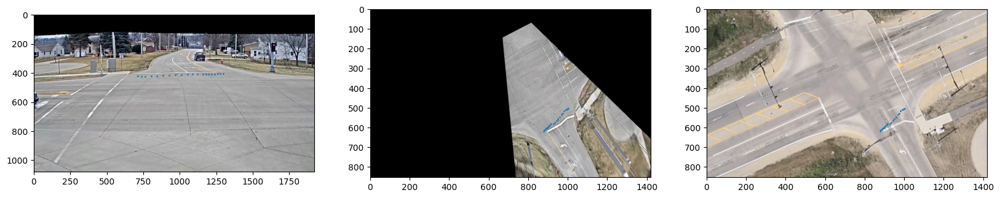

In [4]:

# 把指定轨迹显示在对应相机的图像和鸟瞰图上

c001_id_pd = c001_gt_pd[c001_gt_pd['ID'] == 35]
c001_pt = c001_id_pd[['px', 'py']].values.T
c001_bev = c001_id_pd[['bx', 'by']].values.T

plt.figure()
fig, axes = plt.subplots(1,3, figsize=(20, 4))
axes[0].set_xlim(0,1920)
axes[0].set_ylim(1080,0)
axes[0].imshow(c001_img)
axes[0].scatter(x=c001_pt[0], y=c001_pt[1], s=1)
axes[1].set_xlim(0,1419)
axes[1].set_ylim(853,0)
axes[1].imshow(c001_img_bev)
axes[1].scatter(x=c001_bev[0], y=c001_bev[1], s=1)
axes[2].set_xlim(0,1419)
axes[2].set_ylim(853,0)
axes[2].imshow(bev_img)
axes[2].scatter(x=c001_bev[0], y=c001_bev[1], s=1)
# axes[0].scatter(x=[100.5,200.5,300.5,400.5,500.5], y=[100,200,300,400,500])

#### 2.1.2.单摄像头的全部轨迹显示在对应相机和鸟瞰图上

<Figure size 640x480 with 0 Axes>

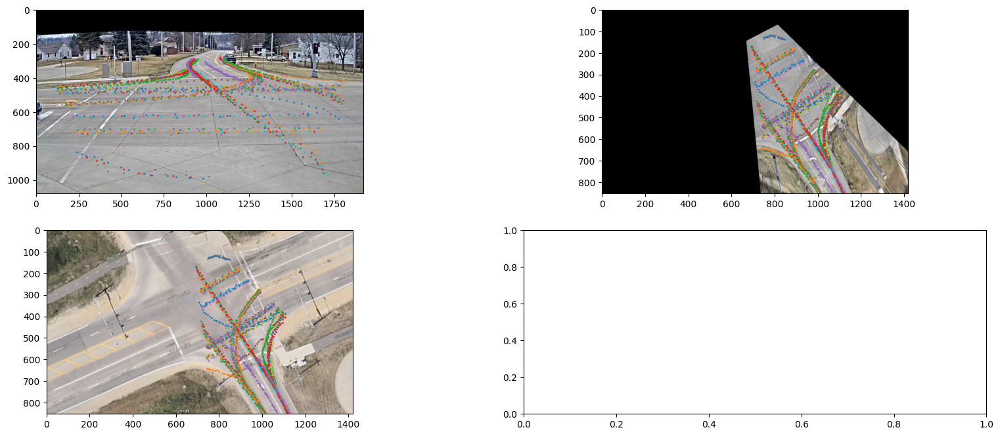

In [5]:
c001_id = np.unique(c001_gt_pd['ID'].values)

plt.figure()
fig, axes = plt.subplots(2,2, figsize=(20, 8))
for id in c001_id:
    c001_id_pd = c001_gt_pd[c001_gt_pd['ID'] == id]
    c001_pt = c001_id_pd[['px', 'py']].values.T
    c001_bev = c001_id_pd[['bx', 'by']].values.T

    axes[0][0].set_xlim(0,1920)
    axes[0][0].set_ylim(1080,0)
    axes[0][0].imshow(c001_img)
    axes[0][0].scatter(x=c001_pt[0], y=c001_pt[1], s=1)
    axes[0][1].set_xlim(0,1419)
    axes[0][1].set_ylim(853,0)
    axes[0][1].imshow(c001_img_bev)
    axes[0][1].scatter(x=c001_bev[0], y=c001_bev[1], s=1)
    axes[1][0].set_xlim(0,1419)
    axes[1][0].set_ylim(853,0)
    axes[1][0].imshow(bev_img)
    axes[1][0].scatter(x=c001_bev[0], y=c001_bev[1], s=1)

### 2.2.以场景为单位的车辆轨迹可视化

#### 2.2.1.全部车辆轨迹在鸟瞰图和各自相机视角的轨迹可视化

In [6]:
class TrackletsVis:
    def  __init__(self, nrow=2,  ncol=5 ) -> None:
        # 初始化img
        plt.figure()
        self.fig, self.axes = plt.subplots(nrows=nrow,ncols=ncol, figsize=(20, 6))
        self.axes[0][0].set_xlim(0,1920)
        self.axes[0][0].set_ylim(1080,0)
        self.axes[0][0].imshow(c001_img)
        self.axes[1][0].set_xlim(0,1419)
        self.axes[1][0].set_ylim(853,0)
        self.axes[1][0].imshow(c001_img_bev)
        
        self.axes[0][1].set_xlim(0,1920)
        self.axes[0][1].set_ylim(1080,0)
        self.axes[0][1].imshow(c002_img)
        self.axes[1][1].set_xlim(0,1419)
        self.axes[1][1].set_ylim(853,0)
        self.axes[1][1].imshow(c002_img_bev)
        
        self.axes[0][2].set_xlim(0,1920)
        self.axes[0][2].set_ylim(1080,0)
        self.axes[0][2].imshow(c003_img)
        self.axes[1][2].set_xlim(0,1419)
        self.axes[1][2].set_ylim(853,0)
        self.axes[1][2].imshow(c003_img_bev)
        
        self.axes[0][3].set_xlim(0,1920)
        self.axes[0][3].set_ylim(1080,0)
        self.axes[0][3].imshow(c004_img)
        self.axes[1][3].set_xlim(0,1419)
        self.axes[1][3].set_ylim(853,0)
        self.axes[1][3].imshow(c004_img_bev)
        
        self.axes[0][4].set_xlim(0,1419)
        self.axes[0][4].set_ylim(853,0)
        self.axes[0][4].imshow(bev_img)
        
        self.axes[1][4].set_xlim(0,1419)
        self.axes[1][4].set_ylim(853,0)
        
    def draw_cam(self, pos=[], points=[]):
        self.axes[pos[0]][pos[1]].scatter(x=points[0], y=points[1], s=1)
    def draw_bev(self, pos=[1, 4], points=[]):
        self.axes[pos[0]][pos[1]].scatter(x=points[0], y=points[1], s=1)
# TrackletsVis()

<Figure size 640x480 with 0 Axes>

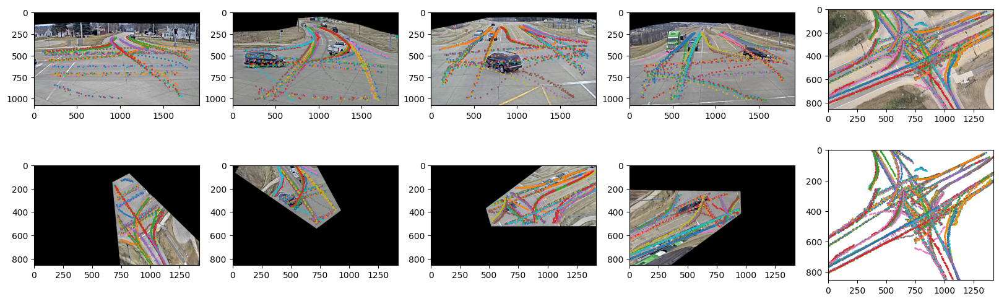

In [7]:
# 全部车道线的可视化
S01_ids = np.unique(S01_pd['ID'].values)

vis = TrackletsVis()
for id in S01_ids:
    S01_tid_pd = S01_pd[S01_pd['ID'] == id]
    cam_ids = np.unique(S01_tid_pd['cam'].values)
    for cam in cam_ids:
        S01_cid_tid_pd = S01_tid_pd[S01_tid_pd['cam']==cam]
        
        pt = S01_cid_tid_pd[['px', 'py']].values.T
        bev = S01_cid_tid_pd[['bx', 'by']].values.T
        vis.draw_cam(pos=[0, int(cam)-1], points=pt)
        vis.draw_cam(pos=[1, int(cam)-1], points=bev)
        vis.draw_bev(pos=[0, 4], points=bev)
        vis.draw_bev(pos=[1, 4], points=bev)
        

#### 2.2.2.指定车辆轨迹的可视化

In [8]:
np.unique(S01_pd['ID'].values)

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,
       35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51,
       52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68,
       69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85,
       86, 87, 88, 89, 90, 91, 92, 93, 94, 95])

<Figure size 640x480 with 0 Axes>

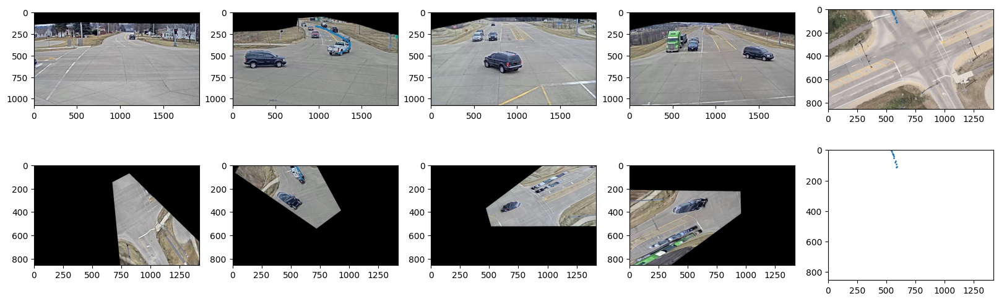

In [9]:
# 指定车道线的可视化
# S01_ids = np.unique(S01_pd['ID'].values)

id = 2
vis = TrackletsVis()
# for id in S01_ids:

S01_tid_pd = S01_pd[S01_pd['ID'] == id]
cam_ids = np.unique(S01_tid_pd['cam'].values)
for cam in cam_ids:
    S01_cid_tid_pd = S01_tid_pd[S01_tid_pd['cam']==cam]
    
    pt = S01_cid_tid_pd[['px', 'py']].values.T
    bev = S01_cid_tid_pd[['bx', 'by']].values.T
    vis.draw_cam(pos=[0, int(cam)-1], points=pt)
    vis.draw_cam(pos=[1, int(cam)-1], points=bev)
    vis.draw_bev(pos=[0, 4], points=bev)
    vis.draw_bev(pos=[1, 4], points=bev)
        

##### a.全部轨迹的可视化，限制为bev图像的宽高，美观

<Figure size 640x480 with 0 Axes>

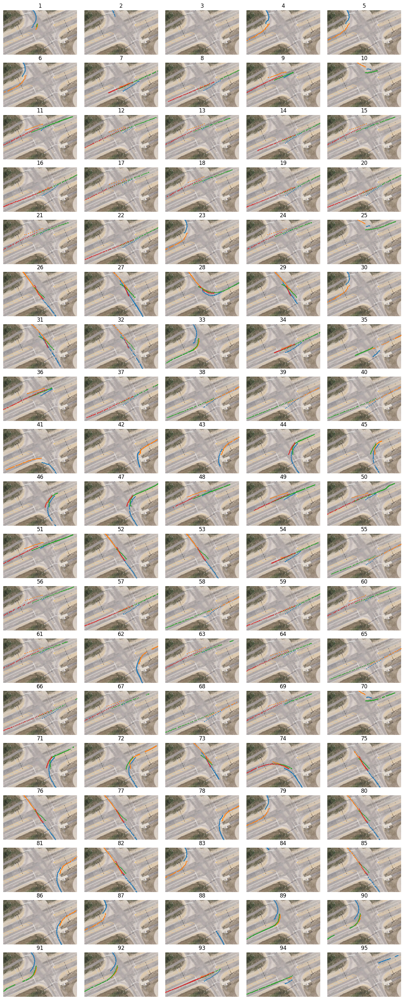

In [10]:
# 一共95条轨迹，画在mxn的表格上
m, n = 19, 5
plt.figure()
fig, axes = plt.subplots(nrows=m,ncols=n, figsize=(16, 40))
plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.1, hspace=0.1)
S01_ids = np.unique(S01_pd['ID'].values)

for idx, id in enumerate(S01_ids):
    # background and idx init
    r, c=idx //n, idx%n
    axes[r][c].set_xlim(0,1419)
    axes[r][c].set_ylim(853,0)
    axes[r][c].axis('off')
    axes[r][c].set_title(idx+1)
    axes[r][c].imshow(bev_img)
   
    S01_tid_pd = S01_pd[S01_pd['ID'] == id]
    cam_ids = np.unique(S01_tid_pd['cam'].values)
    for cam in cam_ids:
        S01_cid_tid_pd = S01_tid_pd[S01_tid_pd['cam']==cam]
        bev = S01_cid_tid_pd[['bx', 'by']].values.T
        axes[r][c].scatter(x=bev[0], y=bev[1], s=1)

##### b.全部轨迹的可视化，无限制宽高，轨迹更完整

1.blue
2.orange
3.green
4.red

<Figure size 640x480 with 0 Axes>

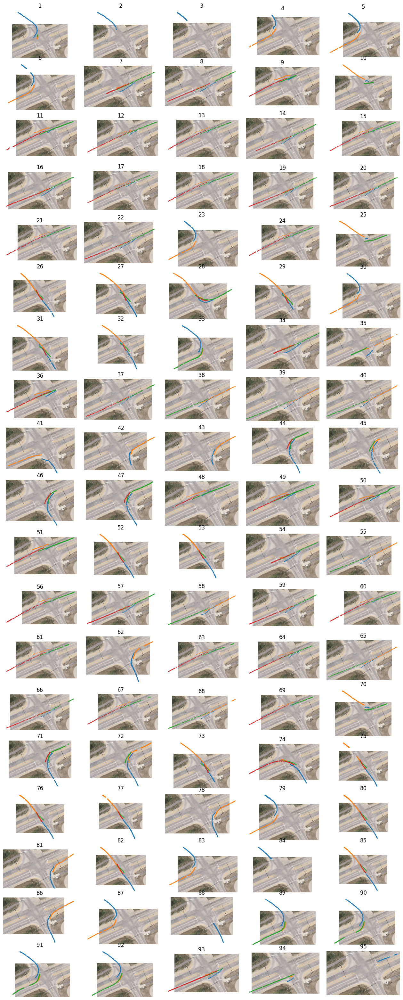

In [11]:
# 一共95条轨迹，画在mxn的表格上
m, n = 19, 5
plt.figure()
fig, axes = plt.subplots(nrows=m,ncols=n, figsize=(16, 40))
plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.1, hspace=0.1)
S01_ids = np.unique(S01_pd['ID'].values)

for idx, id in enumerate(S01_ids):
    # background and idx init
    r, c=idx //n, idx%n
    # axes[r][c].set_xlim(0,1419)
    # axes[r][c].set_ylim(853,0)
    axes[r][c].axis('off')
    axes[r][c].set_title(idx+1)
    axes[r][c].imshow(bev_img)
   
    S01_tid_pd = S01_pd[S01_pd['ID'] == id]
    cam_ids = np.unique(S01_tid_pd['cam'].values)
    for cam in cam_ids:
        S01_cid_tid_pd = S01_tid_pd[S01_tid_pd['cam']==cam]
        bev = S01_cid_tid_pd[['bx', 'by']].values.T
        axes[r][c].scatter(x=bev[0], y=bev[1], s=1)

##### c.指定车辆id和cam的轨迹可视化

In [12]:
np.unique(S01_pd['ID'].values)

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,
       35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51,
       52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68,
       69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85,
       86, 87, 88, 89, 90, 91, 92, 93, 94, 95])

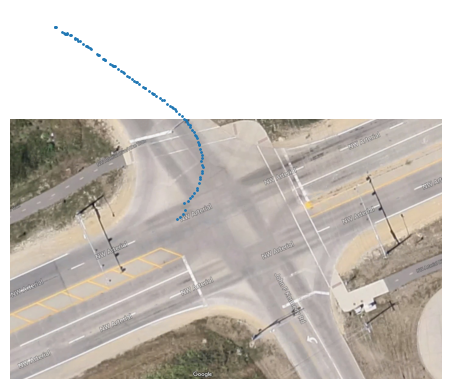

In [13]:
cam='2'
tid=1

plt.figure()
plt.axis('off')
plt.imshow(bev_img)

S01_tid_pd = S01_pd[S01_pd['ID'] == tid]
S01_cid_tid_pd = S01_tid_pd[S01_tid_pd['cam']==cam]
bev = S01_cid_tid_pd[['bx', 'by']].values.T
plt.scatter(x=bev[0], y=bev[1], s=1)

### 2.3.使用Bezier曲线将鸟瞰图轨迹统一为N个连续点。

#### 2.3.1.单个轨迹使用BSpline插值


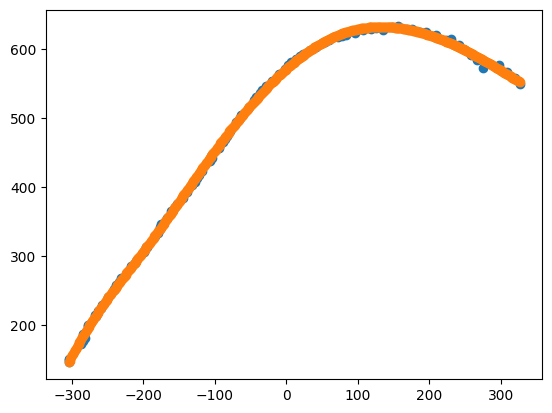

In [14]:
import scipy
import math
# 一个x必须对应1个y，因此，找到该曲线的外接矩形，来确定x是h还是w
# x必须是有序的
min_w, max_w = min(bev[0]), max(bev[0])
min_h, max_h = min(bev[1]), max(bev[1])
width = max_w - min_w
height = max_h - min_h
if width > height:
    x_tmp = bev[0]
    y_tmp = bev[1]
else:
    x_tmp = bev[1]
    y_tmp = bev[0]

# sort xtmp ytmp
x_tmp_sorted = []
y_tmp_sorted = []
for idx in np.argsort(x_tmp):
    x_tmp_sorted.append(x_tmp[idx])
    y_tmp_sorted.append(y_tmp[idx])

plt.figure()
plt.scatter(x=x_tmp_sorted, y=y_tmp_sorted)
if len(x_tmp_sorted) < 5:
    spl = scipy.interpolate.splrep(x=x_tmp_sorted, y=y_tmp_sorted, k=1)
else:
    spl = scipy.interpolate.splrep(x=x_tmp_sorted, y=y_tmp_sorted, s=10*len(x_tmp_sorted)) # 为保证平滑，s越大越好，但是建议和输入点的个数相关。default s= len(x_tmp_sorted) - math.sqrt(2*len(x_tmp_sorted))
bev_x_bs = np.linspace(x_tmp_sorted[0], x_tmp_sorted[-1], 500)
bev_y_bs = scipy.interpolate.splev(bev_x_bs, spl)

plt.scatter(x=bev_x_bs, y=bev_y_bs)

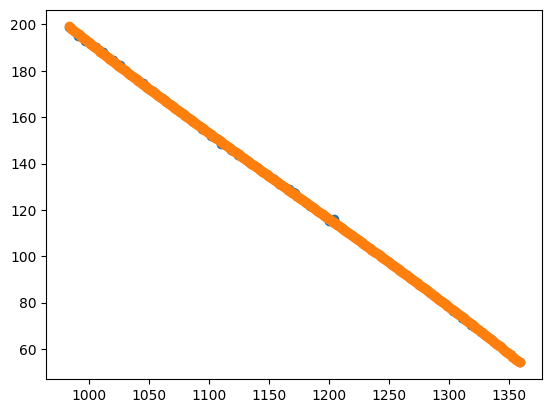

In [20]:
import scipy
def bspline_interpolate(bev):
    min_w, max_w = min(bev[0]), max(bev[0])
    min_h, max_h = min(bev[1]), max(bev[1])
    width = max_w - min_w
    height = max_h - min_h
    if width > height:
        x_tmp = bev[0]
        y_tmp = bev[1]
    else:
        x_tmp = bev[1]
        y_tmp = bev[0]

    # sort xtmp ytmp
    x_tmp_sorted = []
    y_tmp_sorted = []
    for idx in np.argsort(x_tmp):
        x_tmp_sorted.append(x_tmp[idx])
        y_tmp_sorted.append(y_tmp[idx])
    # print(len(x_tmp_sorted))
    if len(x_tmp_sorted) < 5:
        spl = scipy.interpolate.splrep(x=x_tmp_sorted, y=y_tmp_sorted, k=1)
    else:
        spl = scipy.interpolate.splrep(x=x_tmp_sorted, y=y_tmp_sorted, s=10*len(x_tmp_sorted)) # 为保证平滑，s越大越好，但是建议和输入点的个数相关。default s= len(x_tmp_sorted) - math.sqrt(2*len(x_tmp_sorted))
    bev_x_bs = np.linspace(x_tmp_sorted[0], x_tmp_sorted[-1], 500)
    bev_y_bs = scipy.interpolate.splev(bev_x_bs, spl)
    if width > height:
        x_tmp = bev[0]
        y_tmp = bev[1]
        return np.vstack((bev_x_bs.T, bev_y_bs.T))
    else:
        return np.vstack((bev_y_bs.T, bev_x_bs.T))
    
plt.figure()
plt.scatter(x=bev[0], y=bev[1])
bev_bs = bspline_interpolate(bev)
plt.scatter(x=bev_bs[0], y=bev_bs[1])

In [16]:
# bev_x_bs.shape



#### 2.3.2.全部轨迹的鸟瞰图BSpline插值

##### 2.3.2.1 最少轨迹点=5， 新轨迹归一化为60点

<Figure size 640x480 with 0 Axes>

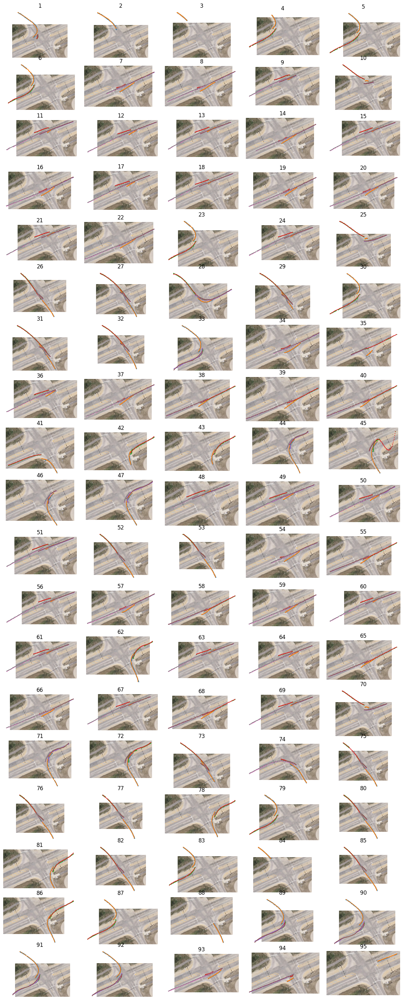

In [28]:
# 一共95条轨迹，画在mxn的表格上
m, n = 19, 5
plt.figure()
fig, axes = plt.subplots(nrows=m,ncols=n, figsize=(16, 40))
plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.1, hspace=0.1)
S01_ids = np.unique(S01_pd['ID'].values)


import scipy
def bspline_interpolate(bev, min_thr=5, point_nums=60):
    if max(bev.shape) < min_thr: 
        return bev
    min_w, max_w = min(bev[0]), max(bev[0])
    min_h, max_h = min(bev[1]), max(bev[1])
    width = max_w - min_w
    height = max_h - min_h
    if width > height:
        x_tmp = bev[0]
        y_tmp = bev[1]
    else:
        x_tmp = bev[1]
        y_tmp = bev[0]

    # sort xtmp ytmp
    x_tmp_sorted = []
    y_tmp_sorted = []
    for idx in np.argsort(x_tmp):
        x_tmp_sorted.append(x_tmp[idx])
        y_tmp_sorted.append(y_tmp[idx])
    # print(len(x_tmp_sorted))
    spl = scipy.interpolate.splrep(x=x_tmp_sorted, y=y_tmp_sorted, s=1000*len(x_tmp_sorted)) # 为保证平滑，s越大越好，但是建议和输入点的个数相关。default s= len(x_tmp_sorted) - math.sqrt(2*len(x_tmp_sorted))
    bev_x_bs = np.linspace(x_tmp_sorted[0], x_tmp_sorted[-1], point_nums)
    bev_y_bs = scipy.interpolate.splev(bev_x_bs, spl)
    if width > height:
        x_tmp = bev[0]
        y_tmp = bev[1]
        return np.vstack((bev_x_bs.T, bev_y_bs.T))
    else:
        return np.vstack((bev_y_bs.T, bev_x_bs.T))
    
# plt.figure()
# plt.scatter(x=bev[0], y=bev[1])
# bev_bs = bspline_interpolate(bev)
# plt.scatter(x=bev_bs[0], y=bev_bs[1])

for idx, id in enumerate(S01_ids):
    # background and idx init
    r, c=idx //n, idx%n
    # axes[r][c].set_xlim(0,1419)
    # axes[r][c].set_ylim(853,0)
    axes[r][c].axis('off')
    axes[r][c].set_title(idx+1)
    axes[r][c].imshow(bev_img)
   
    S01_tid_pd = S01_pd[S01_pd['ID'] == id]
    cam_ids = np.unique(S01_tid_pd['cam'].values)
    for cam in cam_ids:
        S01_cid_tid_pd = S01_tid_pd[S01_tid_pd['cam']==cam]
        bev = S01_cid_tid_pd[['bx', 'by']].values.T
        axes[r][c].scatter(x=bev[0], y=bev[1], s=1)
        bev_bs = bspline_interpolate(bev)
        axes[r][c].scatter(x=bev_bs[0], y=bev_bs[1], s=1, marker='+')


##### 2.3.2.1 最少轨迹点=5， 新轨迹归一化为30点

<Figure size 640x480 with 0 Axes>

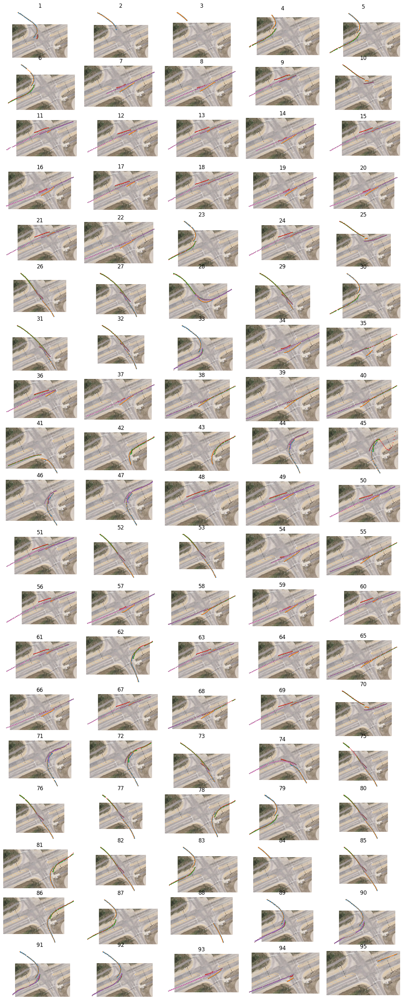

In [29]:
# 一共95条轨迹，画在mxn的表格上
m, n = 19, 5
plt.figure()
fig, axes = plt.subplots(nrows=m,ncols=n, figsize=(16, 40))
plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.1, hspace=0.1)
S01_ids = np.unique(S01_pd['ID'].values)


import scipy
def bspline_interpolate(bev, min_thr=5, point_nums=30):
    if max(bev.shape) < min_thr: 
        return bev
    min_w, max_w = min(bev[0]), max(bev[0])
    min_h, max_h = min(bev[1]), max(bev[1])
    width = max_w - min_w
    height = max_h - min_h
    if width > height:
        x_tmp = bev[0]
        y_tmp = bev[1]
    else:
        x_tmp = bev[1]
        y_tmp = bev[0]

    # sort xtmp ytmp
    x_tmp_sorted = []
    y_tmp_sorted = []
    for idx in np.argsort(x_tmp):
        x_tmp_sorted.append(x_tmp[idx])
        y_tmp_sorted.append(y_tmp[idx])
    # print(len(x_tmp_sorted))
    spl = scipy.interpolate.splrep(x=x_tmp_sorted, y=y_tmp_sorted, s=1000*len(x_tmp_sorted)) # 为保证平滑，s越大越好，但是建议和输入点的个数相关。default s= len(x_tmp_sorted) - math.sqrt(2*len(x_tmp_sorted))
    bev_x_bs = np.linspace(x_tmp_sorted[0], x_tmp_sorted[-1], point_nums)
    bev_y_bs = scipy.interpolate.splev(bev_x_bs, spl)
    if width > height:
        x_tmp = bev[0]
        y_tmp = bev[1]
        return np.vstack((bev_x_bs.T, bev_y_bs.T))
    else:
        return np.vstack((bev_y_bs.T, bev_x_bs.T))
    
# plt.figure()
# plt.scatter(x=bev[0], y=bev[1])
# bev_bs = bspline_interpolate(bev)
# plt.scatter(x=bev_bs[0], y=bev_bs[1])

for idx, id in enumerate(S01_ids):
    # background and idx init
    r, c=idx //n, idx%n
    # axes[r][c].set_xlim(0,1419)
    # axes[r][c].set_ylim(853,0)
    axes[r][c].axis('off')
    axes[r][c].set_title(idx+1)
    axes[r][c].imshow(bev_img)
   
    S01_tid_pd = S01_pd[S01_pd['ID'] == id]
    cam_ids = np.unique(S01_tid_pd['cam'].values)
    for cam in cam_ids:
        S01_cid_tid_pd = S01_tid_pd[S01_tid_pd['cam']==cam]
        bev = S01_cid_tid_pd[['bx', 'by']].values.T
        axes[r][c].scatter(x=bev[0], y=bev[1], s=1)
        bev_bs = bspline_interpolate(bev)
        axes[r][c].scatter(x=bev_bs[0], y=bev_bs[1], s=1, marker='+')
